In [1]:
import pandas as pd
import numpy as np
from numpy import concatenate
import itertools
import re
from math import sqrt
import os
import warnings

import matplotlib.pyplot as plt
from matplotlib import pyplot
import matplotlib

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler

E:\Ananconda_Installation\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
E:\Ananconda_Installation\lib\site-packages\numpy\.libs\libopenblas.XWYDX2IKJW2NMTWSFYNGFUWKQU3LYTCZ.gfortran-win_amd64.dll
E:\Ananconda_Installation\lib\site-packages\numpy\.libs\libopenblas64__v0.3.21-gcc_10_3_0.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


# 1. CANADA

In [2]:
df_MRD_canada=pd.read_excel(r'E:\Jupyter notebooks\hackathon23_somnolence\data\processed\canada.xlsx')

df_MRD_canada.drop(columns=['Unemployment_Rate_MEN','Unemployment_Rate_WOMEN'],inplace=True)
df_MRD_canada.rename(columns={'Unemployment_Rate_TOT':'Value'},inplace=True)

df_MRD_canada['Time']=pd.to_datetime(df_MRD_canada['Time'],format='%Y-%m')
df_MRD_canada=df_MRD_canada.set_index('Time')

for col in df_MRD_canada.columns:
    df_MRD_canada[col]=pd.to_numeric(df_MRD_canada[col],errors='coerce')

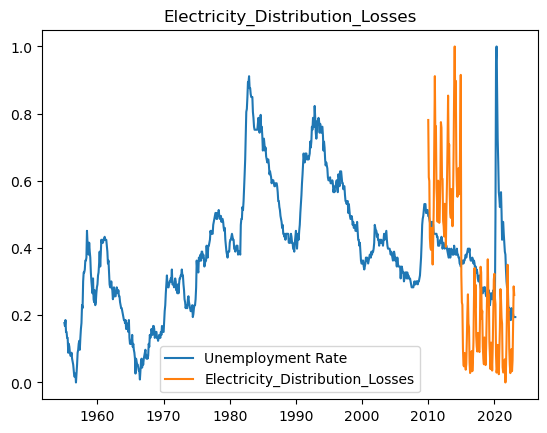

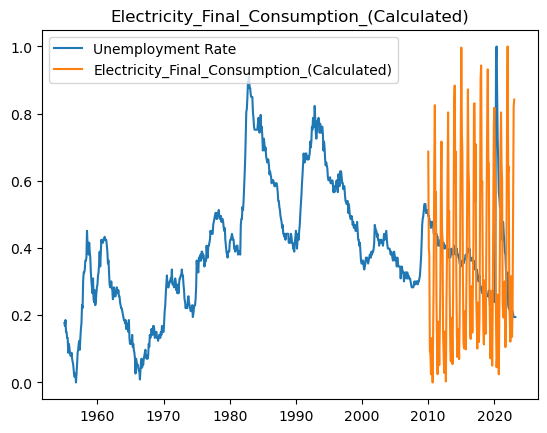

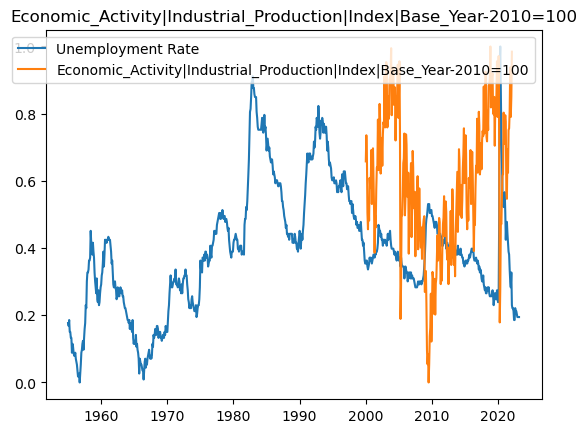

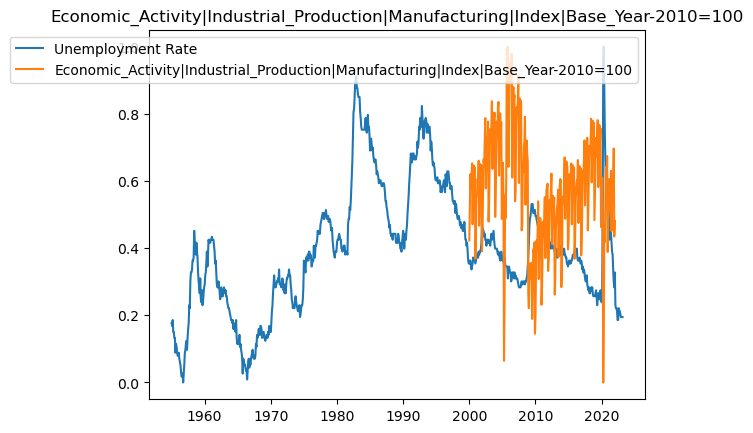

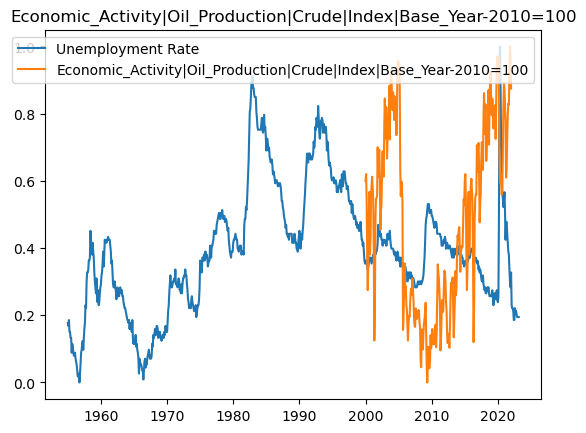

...

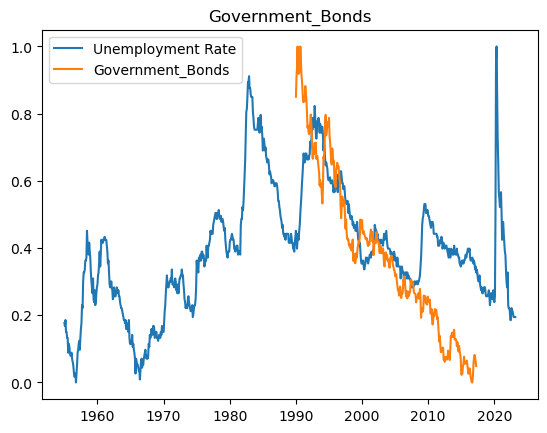

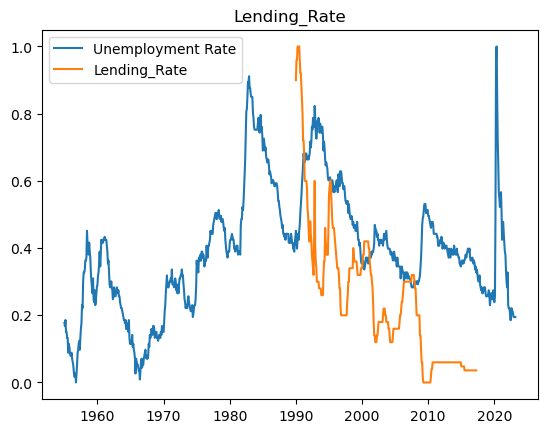

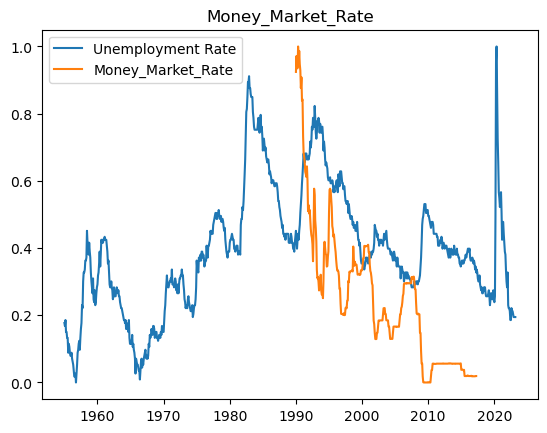

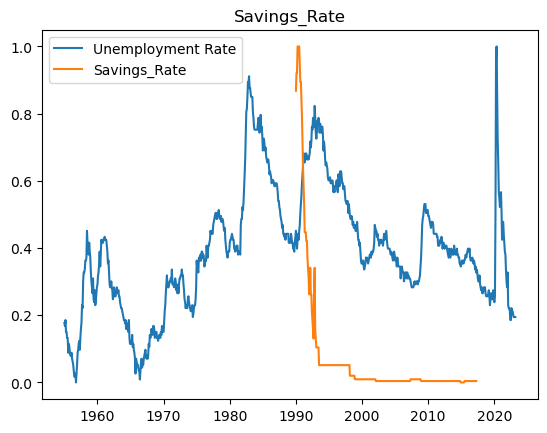

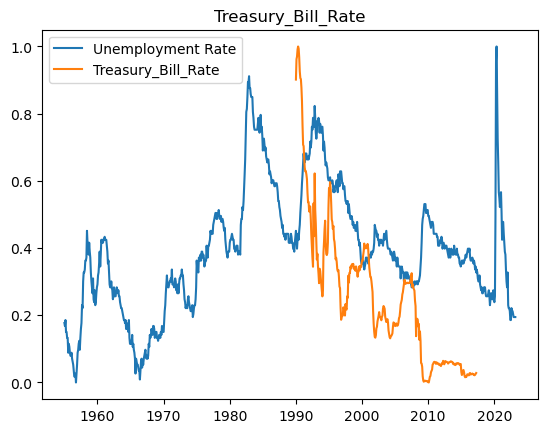

In [3]:
scaler=MinMaxScaler()
df_MRD_canada_scaled=scaler.fit_transform(df_MRD_canada)
df_MRD_canada_scaled=pd.DataFrame(df_MRD_canada_scaled,columns=df_MRD_canada.columns)

df_MRD_canada_scaled.index=df_MRD_canada.index

for col in df_MRD_canada_scaled.columns:
    if col!='Value':
        plt.plot(df_MRD_canada_scaled['Value'],label='Unemployment Rate')
        plt.plot(figsize=(15,5))
        plt.plot(df_MRD_canada_scaled[col],label=col)
        plt.title(col)
        plt.legend()
        plt.show()

In [4]:
for col in df_MRD_canada_scaled.columns:
    max_time=df_MRD_canada_scaled[~df_MRD_canada_scaled[col].isna()].index[-1]
    print('%s : %s'%(col,max_time))

Value : 2023-03-01 00:00:00
Electricity_Distribution_Losses : 2023-01-01 00:00:00
Electricity_Final_Consumption_(Calculated) : 2023-01-01 00:00:00
Economic_Activity|Industrial_Production|Index|Base_Year-2010=100 : 2022-02-01 00:00:00
Economic_Activity|Industrial_Production|Manufacturing|Index|Base_Year-2010=100 : 2022-01-01 00:00:00
Economic_Activity|Oil_Production|Crude|Index|Base_Year-2010=100 : 2022-01-01 00:00:00
Industrial_Production|Seasonally_adjusted|Index|Base_Year-2010=100 : 2022-02-01 00:00:00
Financial_Market_Prices|Equities|End_of_Period|Index|Base_Year-None : 2017-04-01 00:00:00
Financial_Market_Prices|Equities|Index|Base_Year-None : 2017-04-01 00:00:00
Prices|Consumer_Price_Index|All_items|Index|Base_Year-2010=100 : 2023-03-01 00:00:00
Prices|Producer_Price_Index|All_Commodities|Index|Base_Year-2010=100 : 2019-02-01 00:00:00
Employment|Persons|Number_of : 2022-03-01 00:00:00
Labor_Force|Persons|Number_of : 2022-03-01 00:00:00
Labor_Markets|Unemployment_Rate|Percent : 202

In [5]:
col_not_available=['Electricity_Distribution_Losses',
                   'Electricity_Final_Consumption_(Calculated)',
                   'Economic_Activity|Industrial_Production|Index|Base_Year-2010=100',
                   'Economic_Activity|Industrial_Production|Manufacturing|Index|Base_Year-2010=100',
                   'Economic_Activity|Oil_Production|Crude|Index|Base_Year-2010=100',
                   'Industrial_Production|Seasonally_adjusted|Index|Base_Year-2010=100',
                   'Prices|Producer_Price_Index|All_Commodities|Index|Base_Year-2010=100', 
                   'Employment|Persons|Number_of',
                   'Labor_Force|Persons|Number_of',
                   'Labor_Markets|Unemployment_Rate|Percent',
                   'Unemployment|Persons|Number_of',
                   'Business_Confidence',
                   'Central_Bank_Policy_Rate',
                   'Deposit_Rate',
                   'Government_Bonds',
                   'Lending_Rate',
                   'Money_Market_Rate',
                   'Savings_Rate',
                   'Treasury_Bill_Rate',
                   'Financial_Market_Prices|Equities|End_of_Period|Index|Base_Year-None',
                   'Financial_Market_Prices|Equities|Index|Base_Year-None']
                   
col_not_available_high_correlation=[]
                   
df_MRD_canada.drop(columns=col_not_available + col_not_available_high_correlation,inplace=True)
df_MRD_canada.to_excel('Datasets\Canada_LSTM_MRD.xlsx')

# 2. FRANCE

In [6]:
df_MRD_france=pd.read_excel(r'E:\Jupyter notebooks\hackathon23_somnolence\data\processed\france.xlsx')

df_MRD_france.drop(columns=['Unemployment_Rate_MEN','Unemployment_Rate_WOMEN'],inplace=True)
df_MRD_france.rename(columns={'Unemployment_Rate_TOT':'Value'},inplace=True)

df_MRD_france['Time']=pd.to_datetime(df_MRD_france['Time'],format='%Y-%m')
df_MRD_france=df_MRD_france.set_index('Time')

for col in df_MRD_france.columns:
    df_MRD_france[col]=pd.to_numeric(df_MRD_france[col],errors='coerce')

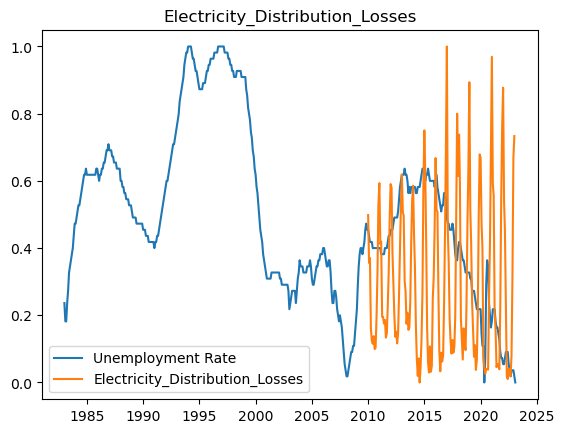

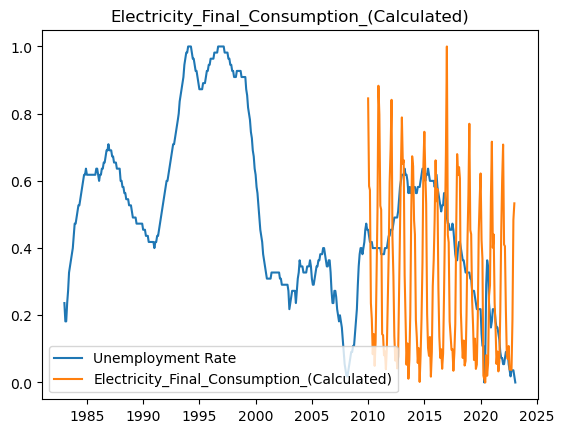

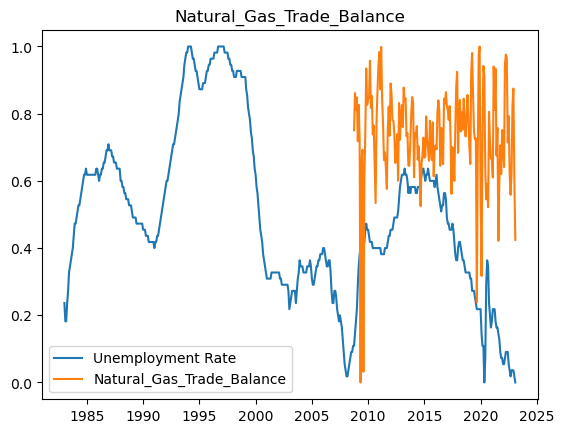

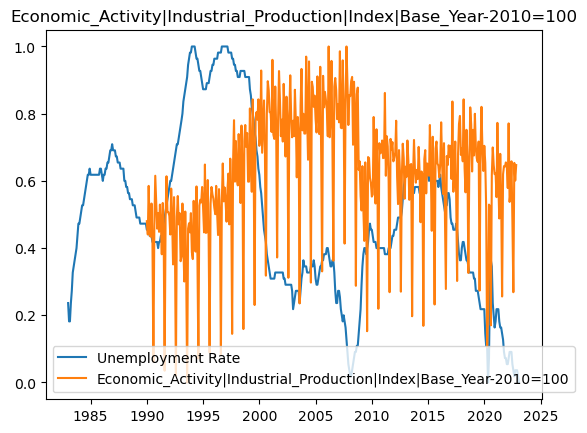

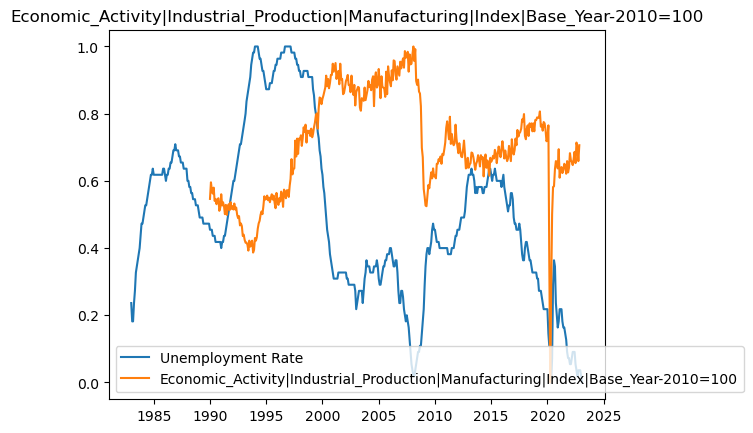

...

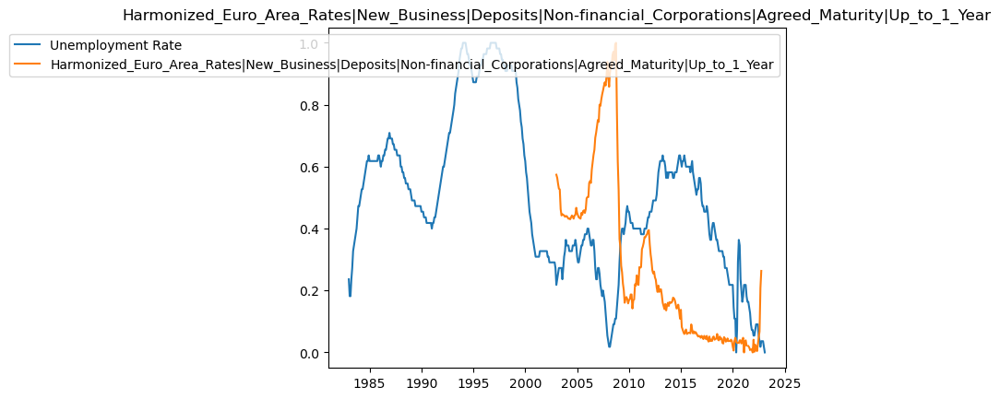

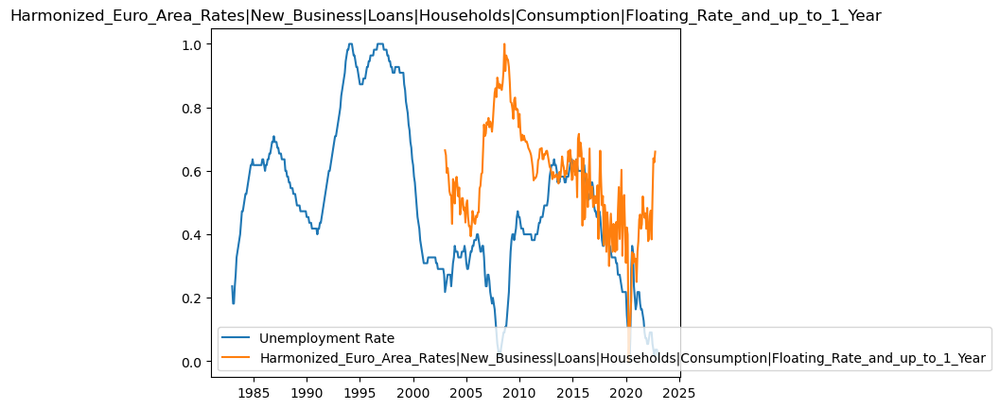

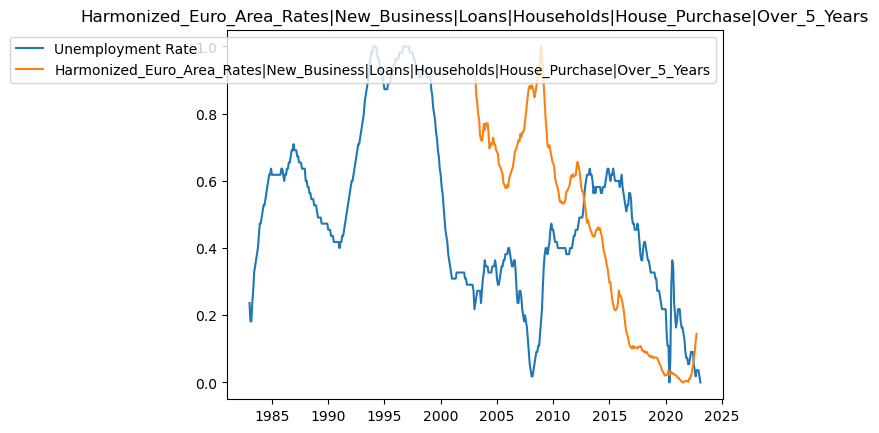

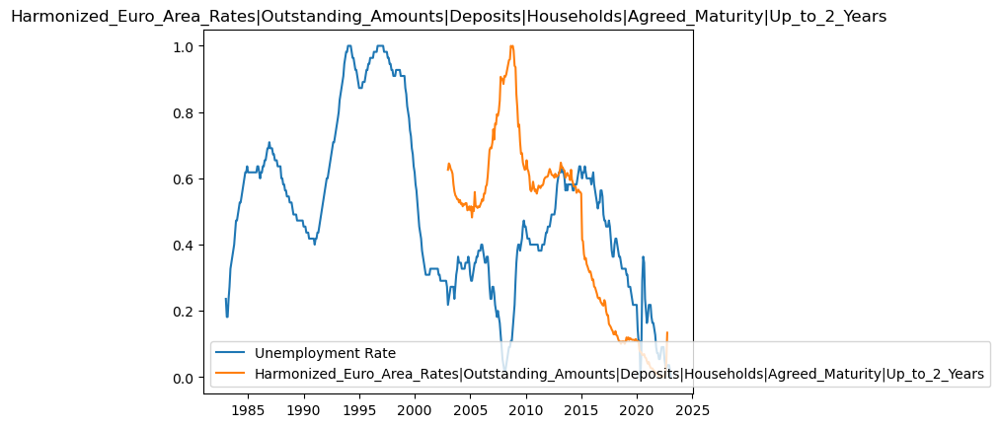

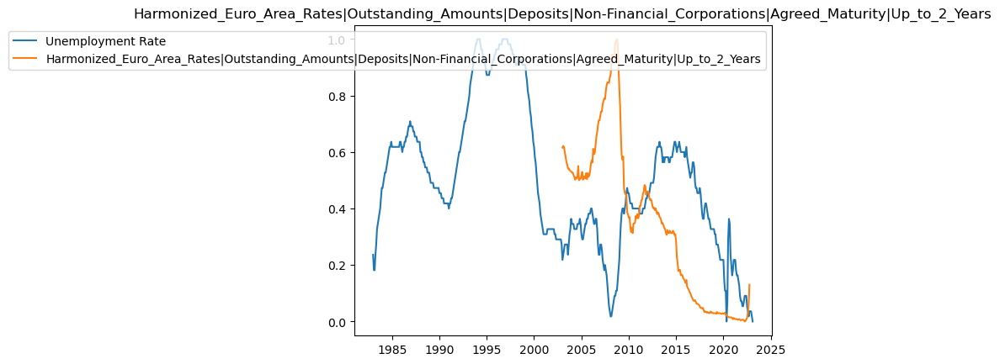

In [7]:
scaler=MinMaxScaler()
df_MRD_france_scaled=scaler.fit_transform(df_MRD_france)
df_MRD_france_scaled=pd.DataFrame(df_MRD_france_scaled,columns=df_MRD_france.columns)

df_MRD_france_scaled.index=df_MRD_france.index

for col in df_MRD_france_scaled.columns:
    if col!='Value':
        plt.plot(df_MRD_france_scaled['Value'],label='Unemployment Rate')
        plt.plot(figsize=(15,5))
        plt.plot(df_MRD_france_scaled[col],label=col)
        plt.title(col)
        plt.legend()
        plt.show()

In [8]:
for col in df_MRD_france_scaled.columns:
    max_time=df_MRD_france_scaled[~df_MRD_france_scaled[col].isna()].index[-1]
    print('%s : %s'%(col,max_time))

Value : 2023-02-01 00:00:00
Electricity_Distribution_Losses : 2023-01-01 00:00:00
Electricity_Final_Consumption_(Calculated) : 2023-01-01 00:00:00
Natural_Gas_Trade_Balance : 2023-02-01 00:00:00
Economic_Activity|Industrial_Production|Index|Base_Year-2010=100 : 2022-11-01 00:00:00
Economic_Activity|Industrial_Production|Manufacturing|Index|Base_Year-2010=100 : 2022-11-01 00:00:00
Industrial_Production|Seasonally_adjusted|Index|Base_Year-2010=100 : 2022-11-01 00:00:00
Financial_Market_Prices|Equities|Index|Base_Year-None : 2017-04-01 00:00:00
Prices|Consumer_Price_Index|All_items|Index|Base_Year-2010=100 : 2023-03-01 00:00:00
Prices|Producer_Price_Index|All_Commodities|Index|Base_Year-2010=100 : 2022-12-01 00:00:00
Labor_Markets|Unemployment_Rate|Percent : 2022-11-01 00:00:00
Labor_Markets|Wage_Rates|Index : 2016-07-01 00:00:00
Unemployment|Persons|Number_of : 2022-11-01 00:00:00
Change_in_Inventories|Nominal|Undjusted|Domestic_Currency : 2022-12-01 00:00:00
Exports_of_Goods_and_Service

In [9]:
col_not_available=['Electricity_Distribution_Losses',
                   'Electricity_Final_Consumption_(Calculated)',
                   'Natural_Gas_Trade_Balance',
                   'Labor_Markets|Unemployment_Rate|Percent',
                   'Labor_Markets|Wage_Rates|Index',
                   'Unemployment|Persons|Number_of',
                   'Deposit_Rate',
                   'Government_Bonds',
                   'Financial_Market_Prices|Equities|Index|Base_Year-None',
                   'Harmonized_Euro_Area_Rates|Loans|Households|Consumer_Credit_and_Other|Up_to_1_Year',
                   'Harmonized_Euro_Area_Rates|Loans|Households|House_Purchase|Over_5_Years',
                   'Harmonized_Euro_Area_Rates|Loans|Non-Financial_Corporations|Up_to_1_Year',
                   'Harmonized_Euro_Area_Rates|New_Business|Deposits|Households|Agreed_Maturity|Up_to_1_Year',
                   'Harmonized_Euro_Area_Rates|New_Business|Deposits|Non-financial_Corporations|Agreed_Maturity|Up_to_1_Year',
                   'Harmonized_Euro_Area_Rates|New_Business|Loans|Households|Consumption|Floating_Rate_and_up_to_1_Year',
                   'Harmonized_Euro_Area_Rates|New_Business|Loans|Households|House_Purchase|Over_5_Years',
                   'Harmonized_Euro_Area_Rates|Outstanding_Amounts|Deposits|Households|Agreed_Maturity|Up_to_2_Years',
                   'Harmonized_Euro_Area_Rates|Outstanding_Amounts|Deposits|Non-Financial_Corporations|Agreed_Maturity|Up_to_2_Years']
                   
col_not_available_high_correlation=[]
                   
df_MRD_france.drop(columns=col_not_available + col_not_available_high_correlation,inplace=True)
df_MRD_france.to_excel('Datasets\France_LSTM_MRD.xlsx')

# 3. GERMANY

In [10]:
df_MRD_germany=pd.read_excel(r'E:\Jupyter notebooks\hackathon23_somnolence\data\processed\germany.xlsx')

df_MRD_germany.drop(columns=['Unemployment_Rate_MEN','Unemployment_Rate_WOMEN'],inplace=True)
df_MRD_germany.rename(columns={'Unemployment_Rate_TOT':'Value'},inplace=True)

df_MRD_germany['Time']=pd.to_datetime(df_MRD_germany['Time'],format='%Y-%m')
df_MRD_germany=df_MRD_germany.set_index('Time')

for col in df_MRD_germany.columns:
    df_MRD_germany[col]=pd.to_numeric(df_MRD_germany[col],errors='coerce')

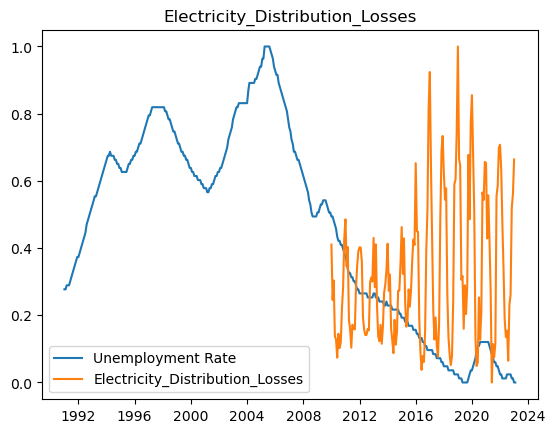

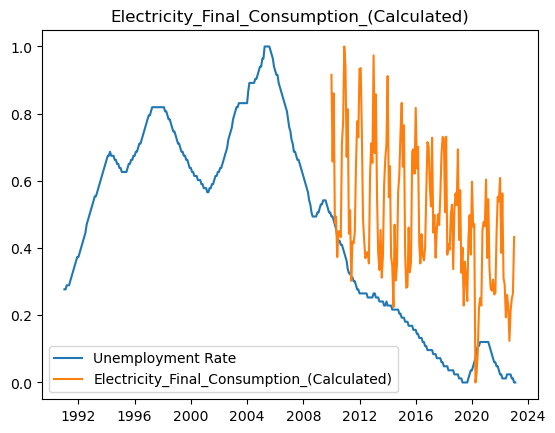

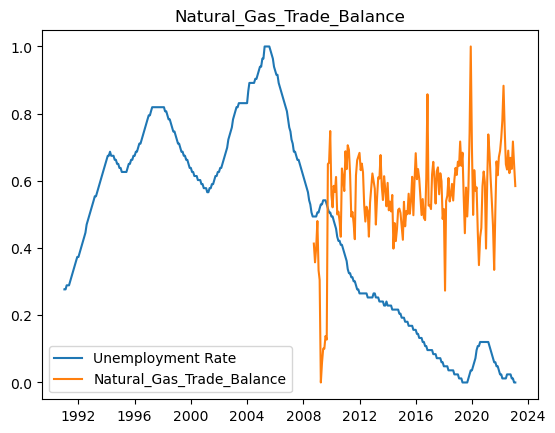

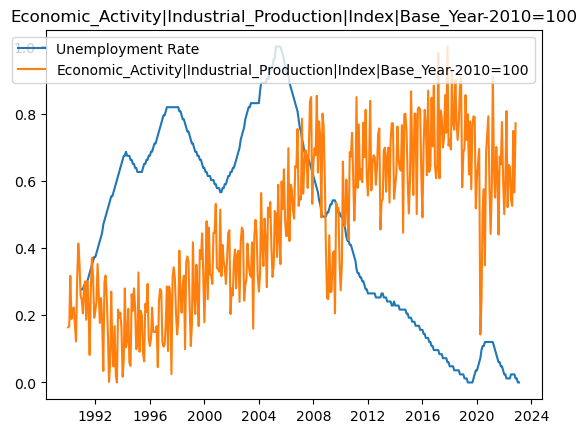

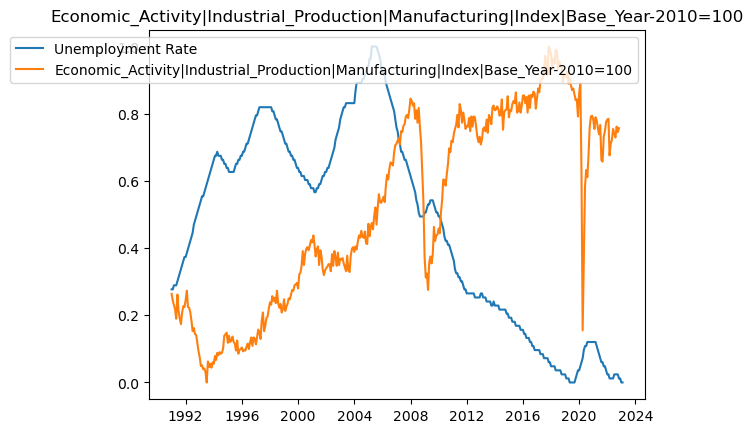

...

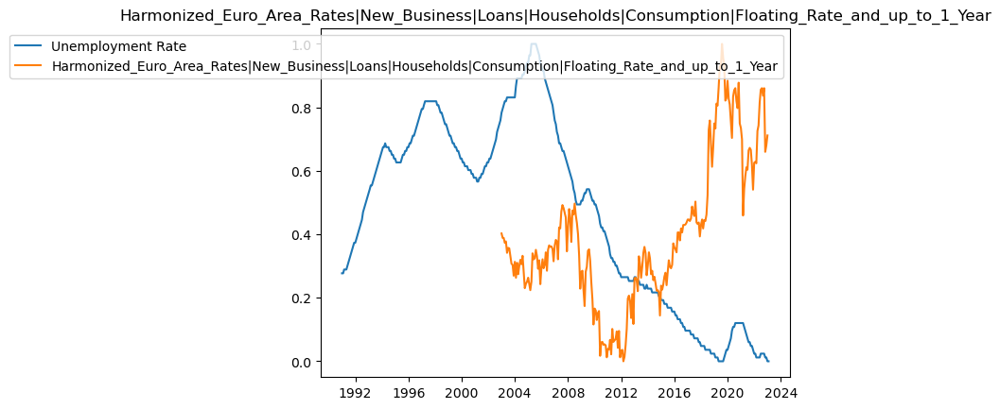

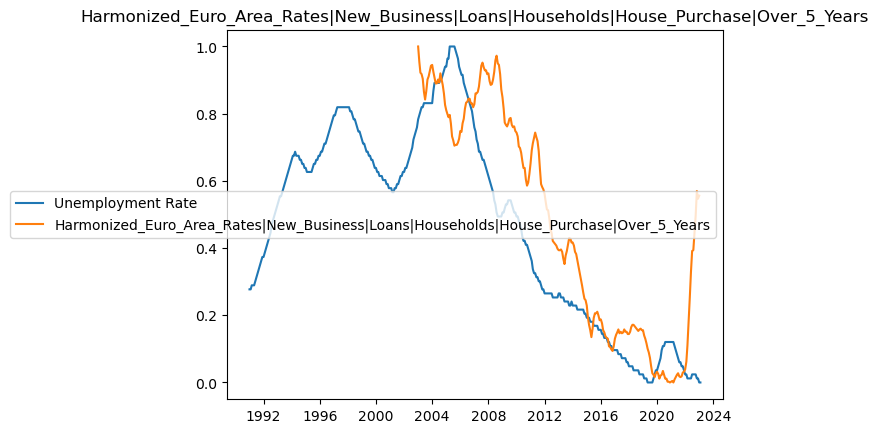

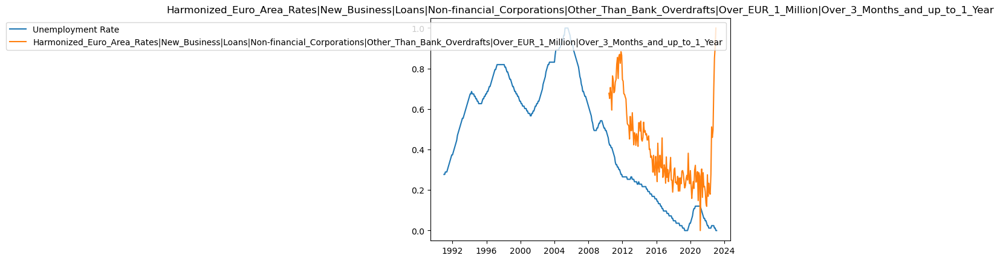

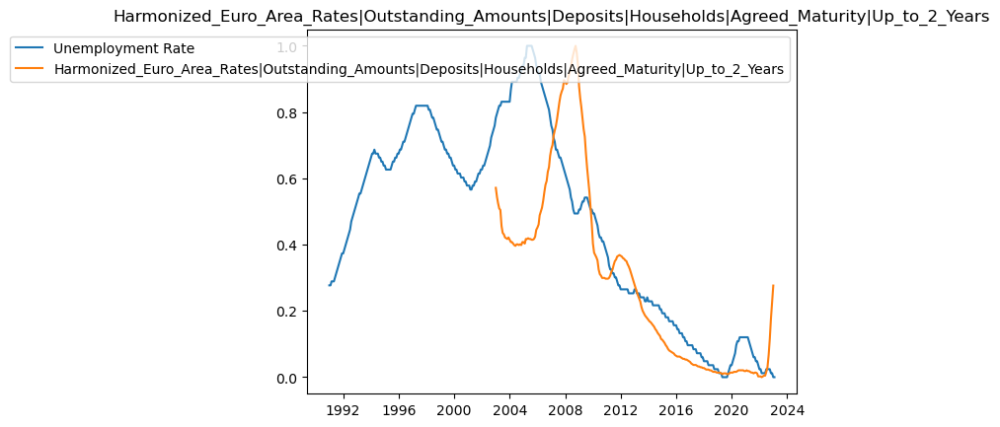

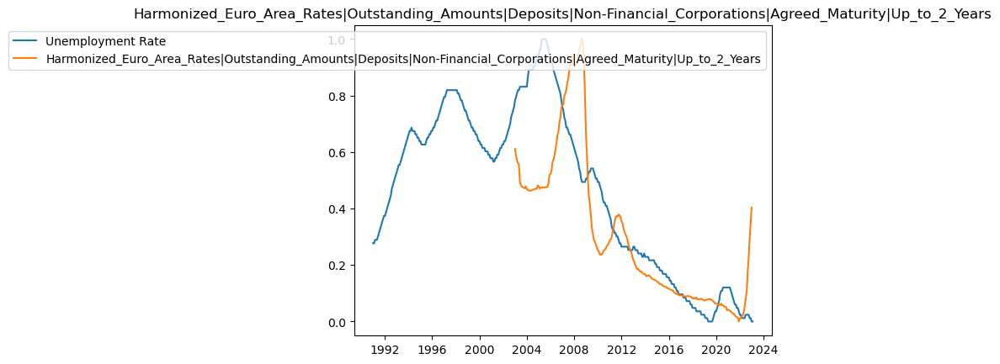

In [11]:
scaler=MinMaxScaler()
df_MRD_germany_scaled=scaler.fit_transform(df_MRD_germany)
df_MRD_germany_scaled=pd.DataFrame(df_MRD_germany_scaled,columns=df_MRD_germany.columns)

df_MRD_germany_scaled.index=df_MRD_germany.index

for col in df_MRD_germany_scaled.columns:
    if col!='Value':
        plt.plot(df_MRD_germany_scaled['Value'],label='Unemployment Rate')
        plt.plot(figsize=(15,5))
        plt.plot(df_MRD_germany_scaled[col],label=col)
        plt.title(col)
        plt.legend()
        plt.show()

In [12]:
for col in df_MRD_germany_scaled.columns:
    max_time=df_MRD_germany_scaled[~df_MRD_germany_scaled[col].isna()].index[-1]
    print('%s : %s'%(col,max_time))

Value : 2023-02-01 00:00:00
Electricity_Distribution_Losses : 2023-01-01 00:00:00
Electricity_Final_Consumption_(Calculated) : 2023-01-01 00:00:00
Natural_Gas_Trade_Balance : 2023-02-01 00:00:00
Economic_Activity|Industrial_Production|Index|Base_Year-2010=100 : 2022-11-01 00:00:00
Economic_Activity|Industrial_Production|Manufacturing|Index|Base_Year-2010=100 : 2022-11-01 00:00:00
Industrial_Production|Seasonally_adjusted|Index|Base_Year-2010=100 : 2022-11-01 00:00:00
Financial_Market_Prices|Equities|End_of_Period|Index|Base_Year-None : 2012-12-01 00:00:00
Prices|Consumer_Price_Index|All_items|Index|Base_Year-2010=100 : 2023-03-01 00:00:00
Prices|Producer_Price_Index|All_Commodities|Index|Base_Year-2010=100 : 2022-11-01 00:00:00
Employment|Persons|Number_of : 2011-06-01 00:00:00
Labor_Markets|Unemployment_Rate|Percent : 2022-11-01 00:00:00
Unemployment|Persons|Number_of : 2022-11-01 00:00:00
Change_in_Inventories|Nominal|Undjusted|Domestic_Currency : 2022-12-01 00:00:00
Exports_of_Goods

In [13]:
col_not_available=['Electricity_Distribution_Losses',
                   'Electricity_Final_Consumption_(Calculated)',
                   'Natural_Gas_Trade_Balance',
                   'Employment|Persons|Number_of',
                   'Labor_Markets|Unemployment_Rate|Percent',
                   'Unemployment|Persons|Number_of',
                   'Government_Bonds',
                   'Financial_Market_Prices|Equities|End_of_Period|Index|Base_Year-None',
                   'Unemployment|Persons|Number_of',
                   'Harmonized_Euro_Area_Rates|New_Business|Loans|Non-financial_Corporations|Other_Than_Bank_Overdrafts|Over_EUR_1_Million|Over_3_Months_and_up_to_1_Year'
                   ]
                   
col_not_available_high_correlation=[]
                   
df_MRD_germany.drop(columns=col_not_available + col_not_available_high_correlation,inplace=True)
df_MRD_germany.to_excel('Datasets\Germany_LSTM_MRD.xlsx')

# 4. ITALY

In [14]:
df_MRD_italy=pd.read_excel(r'E:\Jupyter notebooks\hackathon23_somnolence\data\processed\italy.xlsx')

df_MRD_italy.drop(columns=['Unemployment_Rate_MEN','Unemployment_Rate_WOMEN'],inplace=True)
df_MRD_italy.rename(columns={'Unemployment_Rate_TOT':'Value'},inplace=True)

df_MRD_italy['Time']=pd.to_datetime(df_MRD_italy['Time'],format='%Y-%m')
df_MRD_italy=df_MRD_italy.set_index('Time')

for col in df_MRD_italy.columns:
    df_MRD_italy[col]=pd.to_numeric(df_MRD_italy[col],errors='coerce')

E:\Ananconda_Installation\lib\site-packages\sklearn\preprocessing\_data.py:461: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
E:\Ananconda_Installation\lib\site-packages\sklearn\preprocessing\_data.py:462: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)


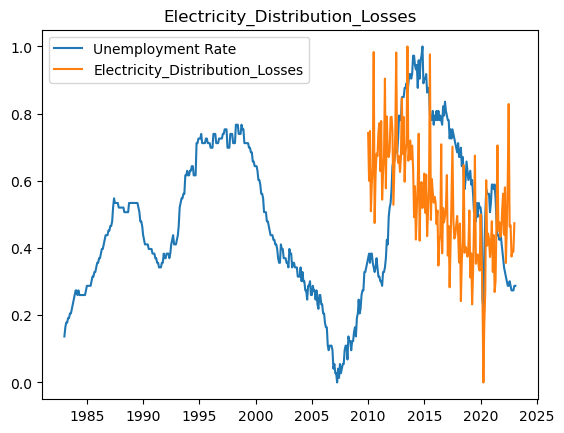

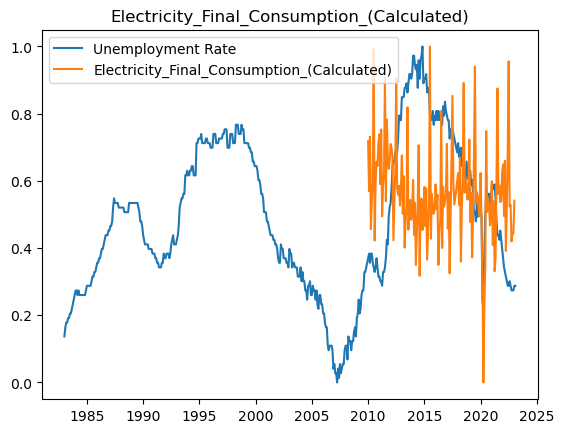

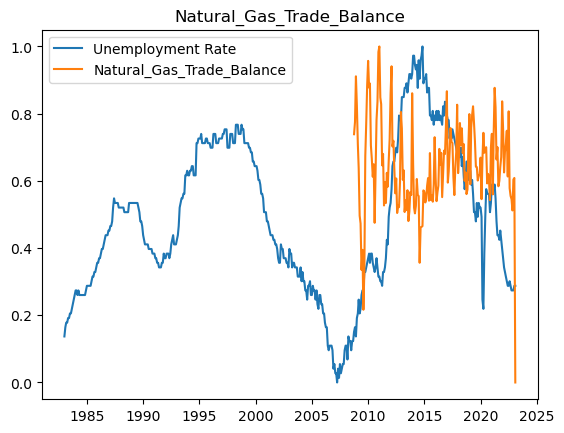

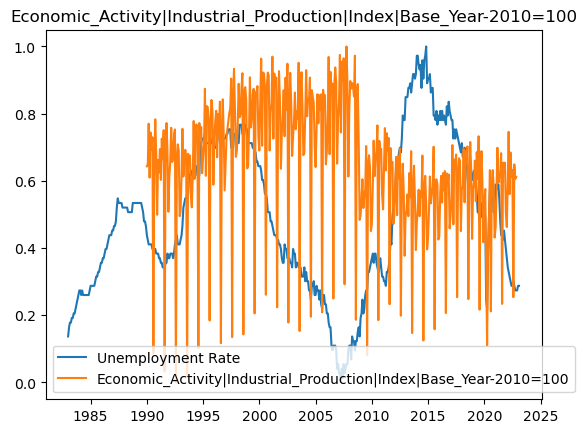

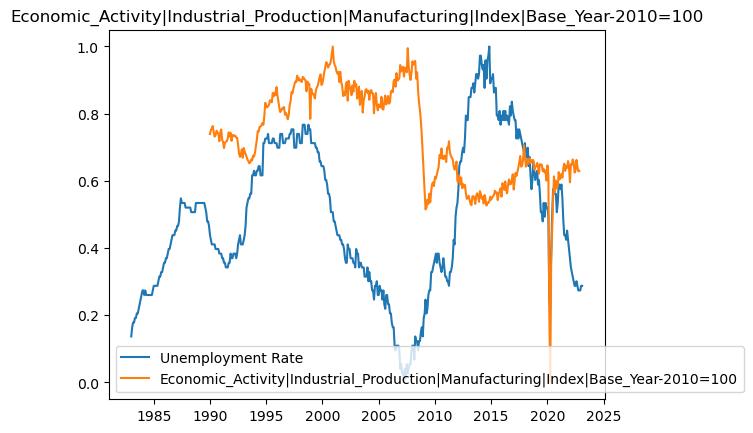

...

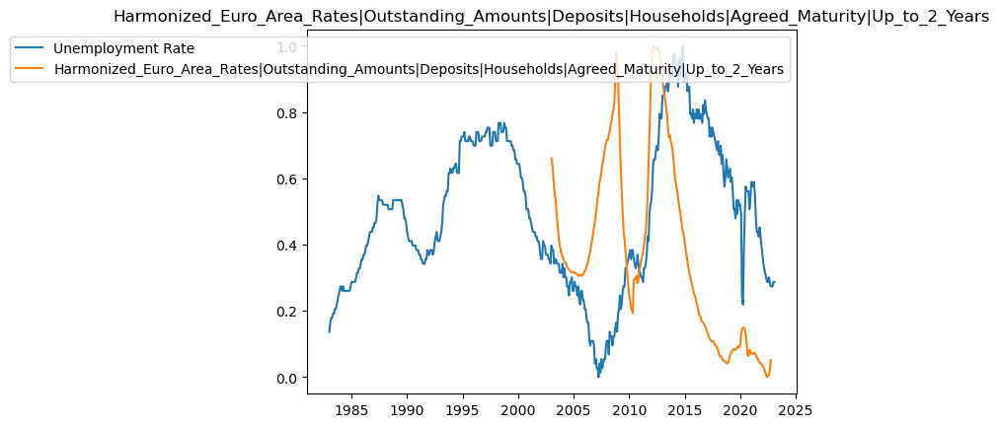

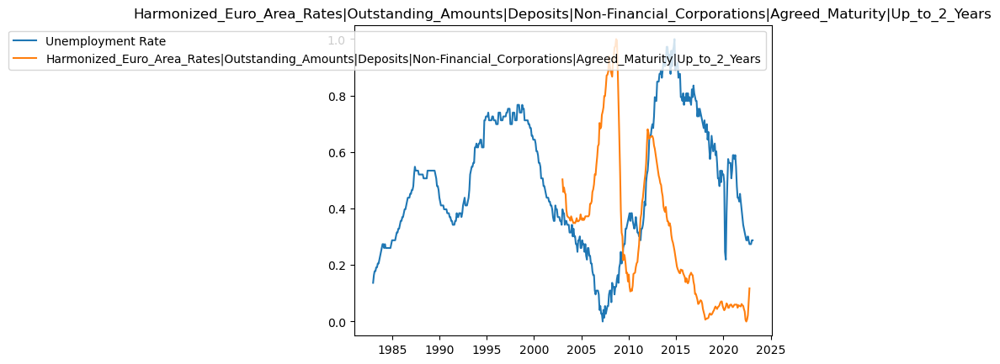

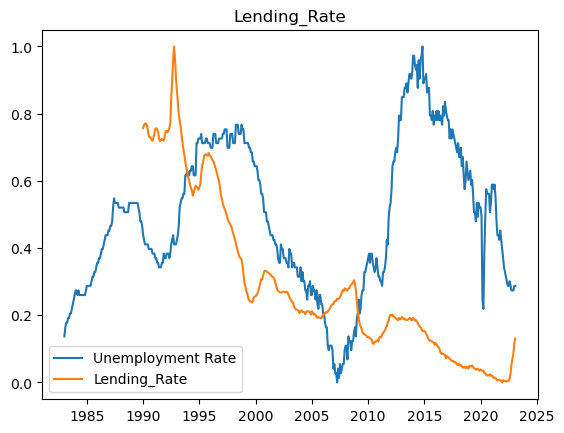

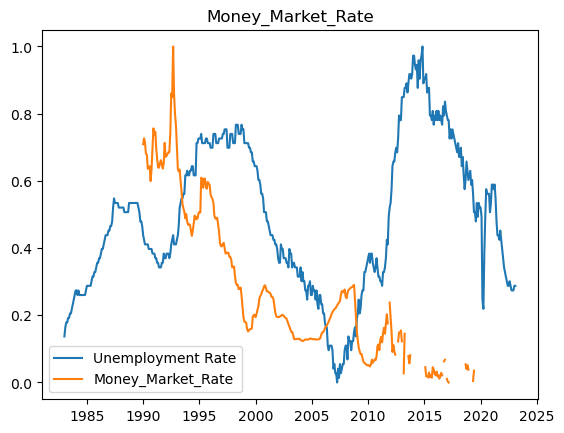

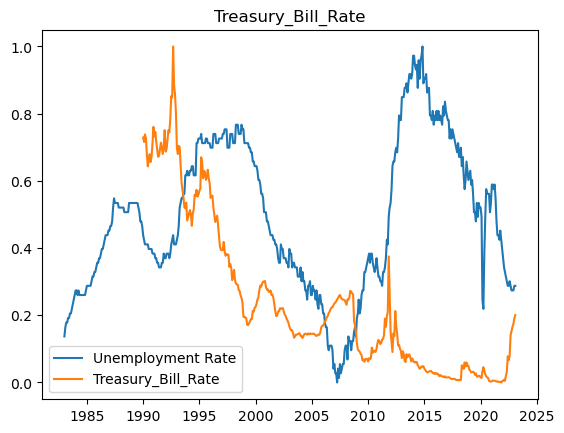

In [15]:
scaler=MinMaxScaler()
df_MRD_italy_scaled=scaler.fit_transform(df_MRD_italy)
df_MRD_italy_scaled=pd.DataFrame(df_MRD_italy_scaled,columns=df_MRD_italy.columns)

df_MRD_italy_scaled.index=df_MRD_italy.index

for col in df_MRD_italy_scaled.columns:
    if col!='Value':
        plt.plot(df_MRD_italy_scaled['Value'],label='Unemployment Rate')
        plt.plot(figsize=(15,5))
        plt.plot(df_MRD_italy_scaled[col],label=col)
        plt.title(col)
        plt.legend()
        plt.show()

In [16]:
for col in df_MRD_italy_scaled.columns:
    try:
        max_time=df_MRD_italy_scaled[~df_MRD_italy_scaled[col].isna()].index[-1]
        print('%s : %s'%(col,max_time))
    except IndexError:
        print('%s : No Value Exists'%(col))

Value : 2023-02-01 00:00:00
Electricity_Distribution_Losses : 2023-01-01 00:00:00
Electricity_Final_Consumption_(Calculated) : 2023-01-01 00:00:00
Natural_Gas_Trade_Balance : 2023-02-01 00:00:00
Economic_Activity|Industrial_Production|Index|Base_Year-2010=100 : 2022-11-01 00:00:00
Economic_Activity|Industrial_Production|Manufacturing|Index|Base_Year-2010=100 : 2022-11-01 00:00:00
Industrial_Production|Seasonally_adjusted|Index|Base_Year-2010=100 : 2022-11-01 00:00:00
Financial_Market_Prices|Equities|Index|Base_Year-None : 2023-03-01 00:00:00
Prices|Consumer_Price_Index|All_items|Index|Base_Year-2010=100 : 2023-03-01 00:00:00
Prices|Producer_Price_Index|All_Commodities|Index|Base_Year-2010=100 : 2021-02-01 00:00:00
Labor_Markets|Unemployment_Rate|Percent : 2022-11-01 00:00:00
Labor_Markets|Wage_Rates|Index : 2020-09-01 00:00:00
Unemployment|Persons|Number_of : 2022-11-01 00:00:00
Change_in_Inventories|Nominal|Undjusted|Domestic_Currency : 2022-12-01 00:00:00
Exports_of_Goods_and_Service

In [17]:
col_not_available=['Electricity_Distribution_Losses',
                   'Electricity_Final_Consumption_(Calculated)',
                   'Natural_Gas_Trade_Balance',
                   'Statistical_Discrepancy_in_GDP|Nominal|Undjusted|Domestic_Currency',
                   'Statistical_Discrepancy_in_GDP|Nominal|Seasonally_Adjusted|Domestic_Currency',
                   'Harmonized_Euro_Area_Rates|Loans|Households|Consumer_Credit_and_Other|Up_to_1_Year',
                   'Harmonized_Euro_Area_Rates|Loans|Households|House_Purchase|Over_5_Years',
                   'Harmonized_Euro_Area_Rates|Loans|Non-Financial_Corporations|Up_to_1_Year',
                   'Harmonized_Euro_Area_Rates|New_Business|Deposits|Households|Agreed_Maturity|Up_to_1_Year',
                   'Harmonized_Euro_Area_Rates|New_Business|Deposits|Non-financial_Corporations|Agreed_Maturity|Up_to_1_Year',
                   'Harmonized_Euro_Area_Rates|New_Business|Loans|Households|Consumption|Floating_Rate_and_up_to_1_Year',
                   'Harmonized_Euro_Area_Rates|New_Business|Loans|Households|House_Purchase|Over_5_Years',
                   'Harmonized_Euro_Area_Rates|Outstanding_Amounts|Deposits|Households|Agreed_Maturity|Up_to_2_Years',
                   'Harmonized_Euro_Area_Rates|Outstanding_Amounts|Deposits|Non-Financial_Corporations|Agreed_Maturity|Up_to_2_Years',
                   'Prices|Producer_Price_Index|All_Commodities|Index|Base_Year-2010=100',
                   'Labor_Markets|Unemployment_Rate|Percent',
                   'Labor_Markets|Wage_Rates|Index',
                   'Unemployment|Persons|Number_of',
                   'Money_Market_Rate'
                   ]
                   
col_not_available_high_correlation=[]
                   
df_MRD_italy.drop(columns=col_not_available + col_not_available_high_correlation,inplace=True)
df_MRD_italy.to_excel('Datasets\Italy_LSTM_MRD.xlsx')

# 5. UNITED KINGDOM

In [18]:
df_MRD_uk=pd.read_excel(r'E:\Jupyter notebooks\hackathon23_somnolence\data\processed\uk.xlsx')

df_MRD_uk.drop(columns=['Unemployment_Rate_MEN','Unemployment_Rate_WOMEN'],inplace=True)
df_MRD_uk.rename(columns={'Unemployment_Rate_TOT':'Value'},inplace=True)

df_MRD_uk['Time']=pd.to_datetime(df_MRD_uk['Time'],format='%Y-%m')
df_MRD_uk=df_MRD_uk.set_index('Time')

for col in df_MRD_uk.columns:
    df_MRD_uk[col]=pd.to_numeric(df_MRD_uk[col],errors='coerce')

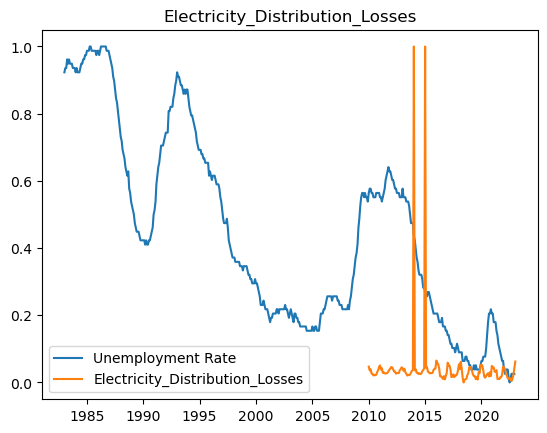

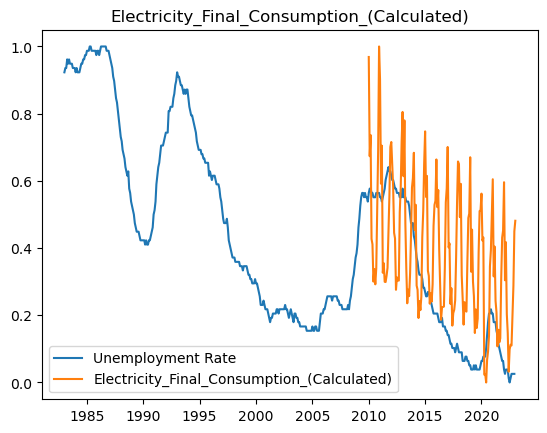

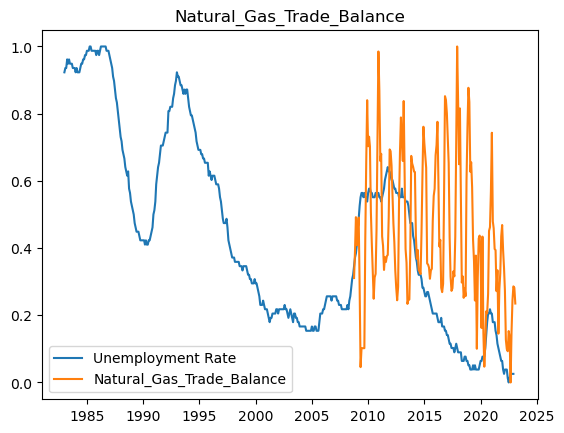

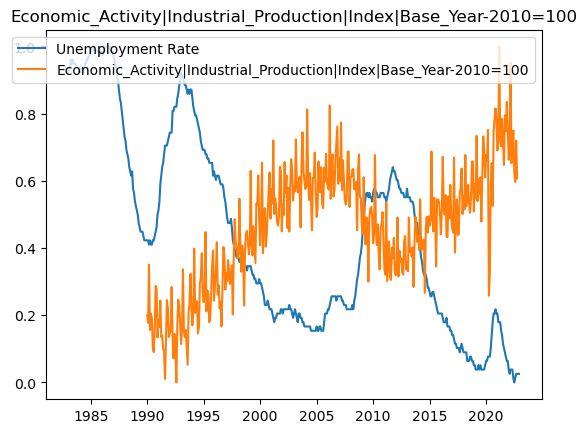

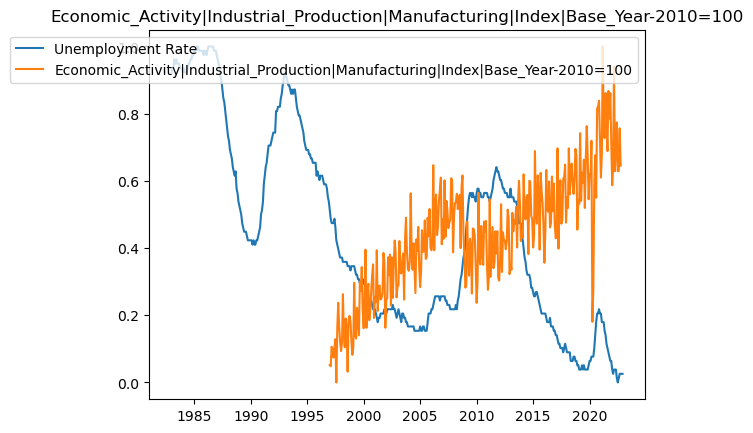

...

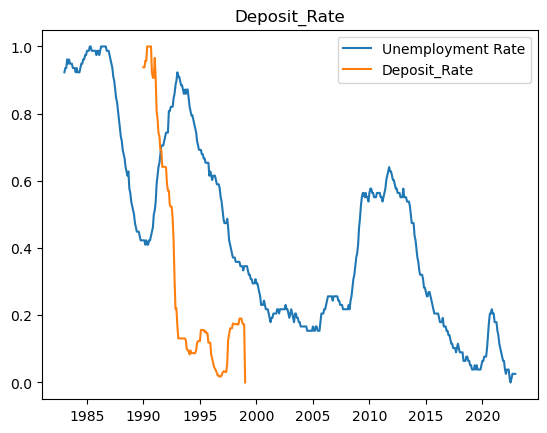

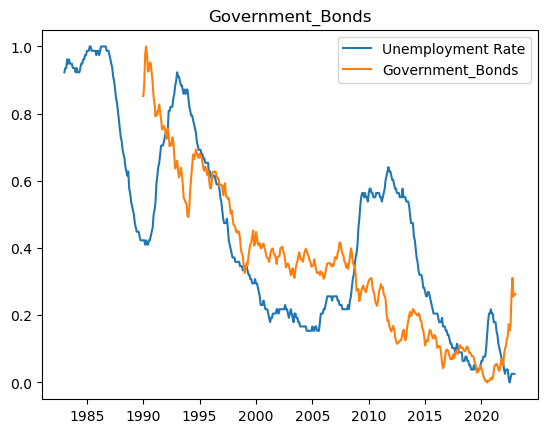

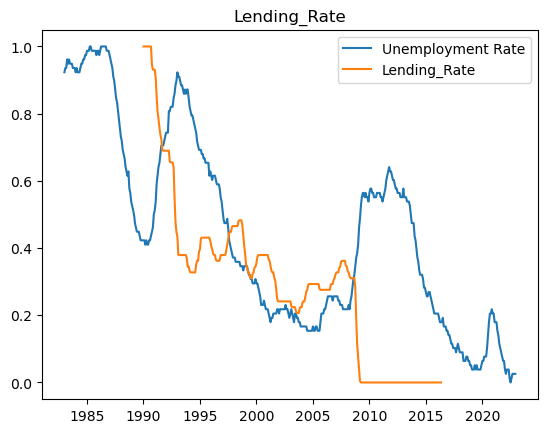

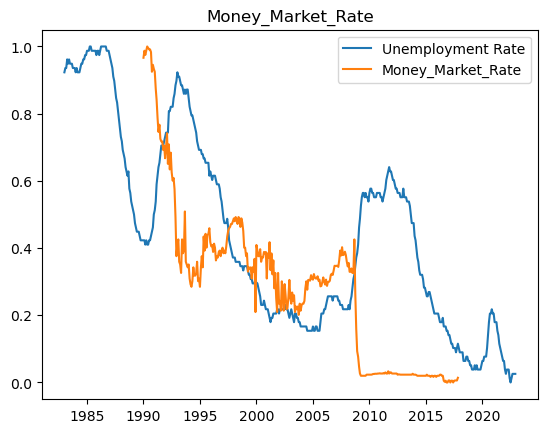

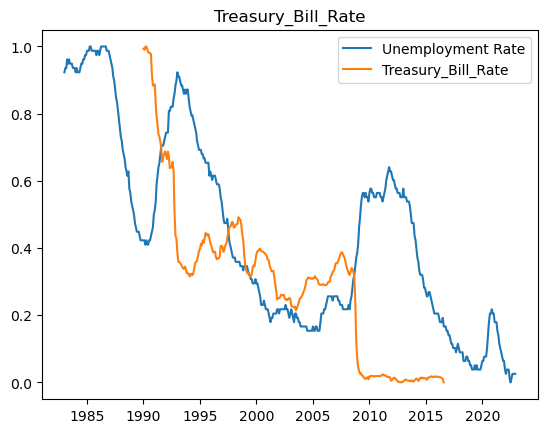

In [19]:
scaler=MinMaxScaler()
df_MRD_uk_scaled=scaler.fit_transform(df_MRD_uk)
df_MRD_uk_scaled=pd.DataFrame(df_MRD_uk_scaled,columns=df_MRD_uk.columns)

df_MRD_uk_scaled.index=df_MRD_uk.index

for col in df_MRD_uk_scaled.columns:
    if col!='Value':
        plt.plot(df_MRD_uk_scaled['Value'],label='Unemployment Rate')
        plt.plot(figsize=(15,5))
        plt.plot(df_MRD_uk_scaled[col],label=col)
        plt.title(col)
        plt.legend()
        plt.show()

In [20]:
for col in df_MRD_uk_scaled.columns:
    try:
        max_time=df_MRD_uk_scaled[~df_MRD_uk_scaled[col].isna()].index[-1]
        print('%s : %s'%(col,max_time))
    except IndexError:
        print('%s : No Value Exists'%(col))

Value : 2022-12-01 00:00:00
Electricity_Distribution_Losses : 2023-01-01 00:00:00
Electricity_Final_Consumption_(Calculated) : 2023-01-01 00:00:00
Natural_Gas_Trade_Balance : 2023-02-01 00:00:00
Economic_Activity|Industrial_Production|Index|Base_Year-2010=100 : 2022-10-01 00:00:00
Economic_Activity|Industrial_Production|Manufacturing|Index|Base_Year-2010=100 : 2022-10-01 00:00:00
Industrial_Production|Seasonally_adjusted|Index|Base_Year-2010=100 : 2022-10-01 00:00:00
Financial_Market_Prices|Equities|End_of_Period|Index|Base_Year-None : 2016-08-01 00:00:00
Financial_Market_Prices|Equities|Index|Base_Year-None : 2016-08-01 00:00:00
Prices|Consumer_Price_Index|All_items|Index|Base_Year-2010=100 : 2023-03-01 00:00:00
Prices|Producer_Price_Index|All_Commodities|Index|Base_Year-2010=100 : 2022-10-01 00:00:00
Labor_Markets|Unemployment_Rate|Percent : 2020-09-01 00:00:00
Unemployment|Persons|Number_of : 2020-09-01 00:00:00
Change_in_Inventories|Nominal|Undjusted|Domestic_Currency : 2022-12-01 

In [21]:
col_not_available=['Electricity_Distribution_Losses',
                   'Electricity_Final_Consumption_(Calculated)',
                   'Natural_Gas_Trade_Balance',
                   'Statistical_Discrepancy_in_GDP|Nominal|Undjusted|Domestic_Currency',
                   'Statistical_Discrepancy_in_GDP|Nominal|Seasonally_Adjusted|Domestic_Currency',
                   'Statistical_Discrepancy_in_GDP|Real|Seasonally_Adjusted|Domestic_Currency|Base_Year-2019.0',
                   'Financial_Market_Prices|Equities|End_of_Period|Index|Base_Year-None',
                   'Financial_Market_Prices|Equities|Index|Base_Year-None',
                   'Labor_Markets|Unemployment_Rate|Percent',
                   'Unemployment|Persons|Number_of',
                   'Central_Bank_Policy_Rate',
                   'Deposit_Rate',
                   'Lending_Rate',
                   'Money_Market_Rate',
                   'Treasury_Bill_Rate'
                   ]
                   
col_not_available_high_correlation=[]
                   
df_MRD_uk.drop(columns=col_not_available + col_not_available_high_correlation,inplace=True)
df_MRD_uk.to_excel(r'Datasets\UK_LSTM_MRD.xlsx')

# 6. US

In [22]:
df_MRD_us=pd.read_excel(r'E:\Jupyter notebooks\hackathon23_somnolence\data\processed\usa.xlsx')

df_MRD_us.drop(columns=['Unemployment_Rate_MEN','Unemployment_Rate_WOMEN'],inplace=True)
df_MRD_us.rename(columns={'Unemployment_Rate_TOT':'Value'},inplace=True)

df_MRD_us['Time']=pd.to_datetime(df_MRD_us['Time'],format='%Y-%m')
df_MRD_us=df_MRD_us.set_index('Time')

for col in df_MRD_us.columns:
    df_MRD_us[col]=pd.to_numeric(df_MRD_us[col],errors='coerce')

E:\Ananconda_Installation\lib\site-packages\sklearn\preprocessing\_data.py:461: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
E:\Ananconda_Installation\lib\site-packages\sklearn\preprocessing\_data.py:462: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)


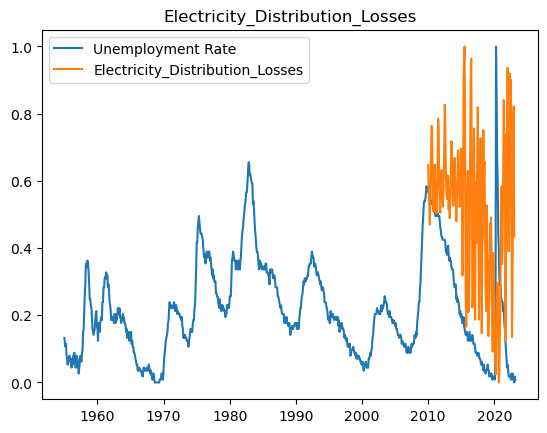

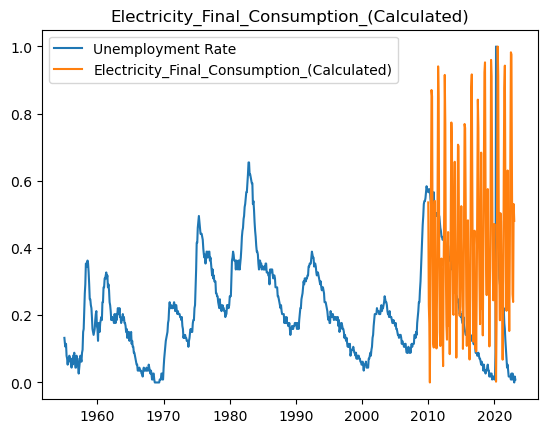

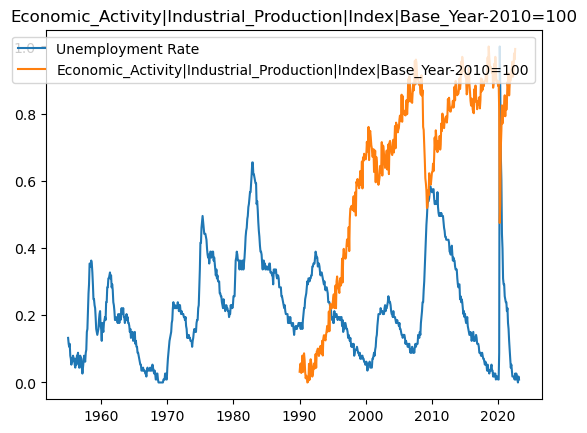

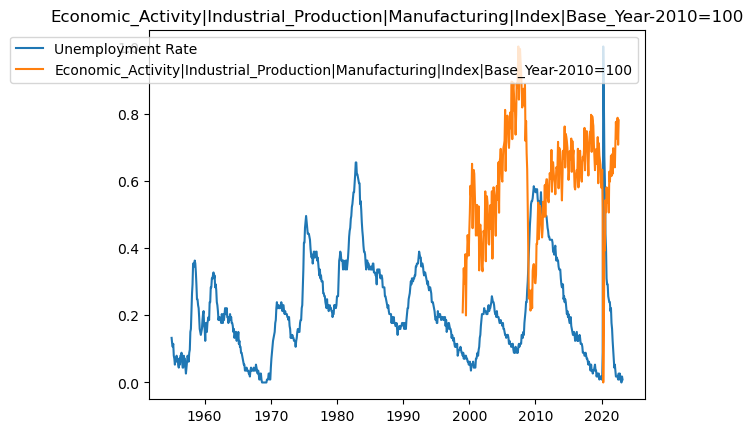

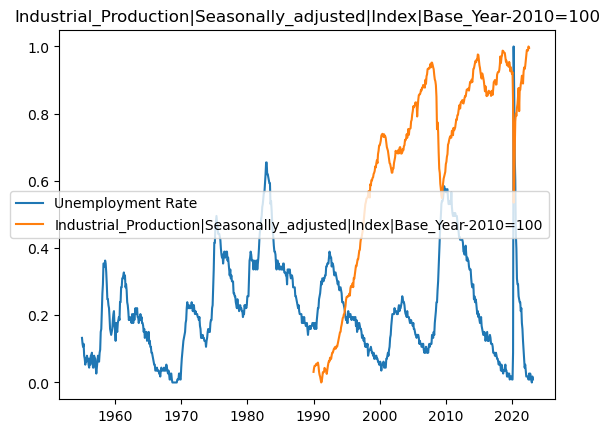

...

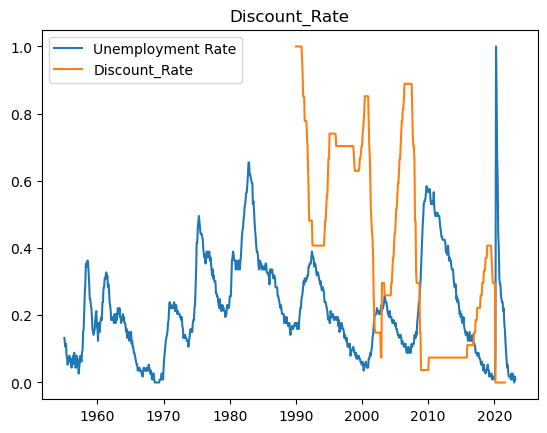

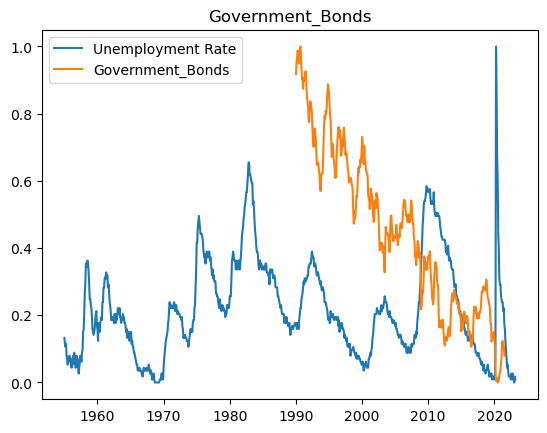

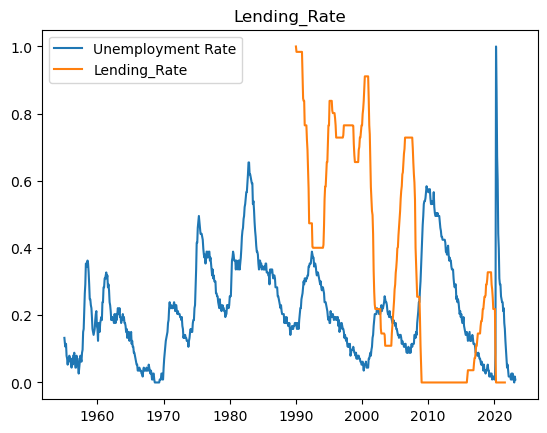

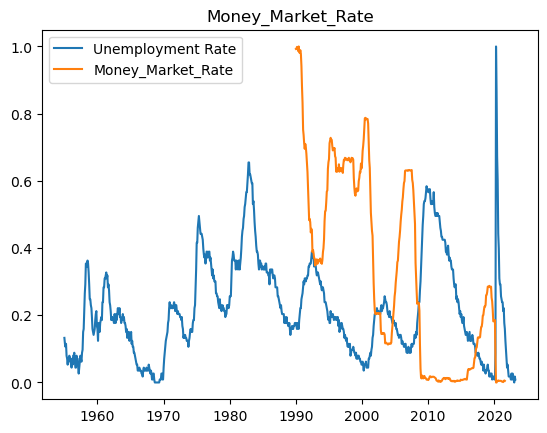

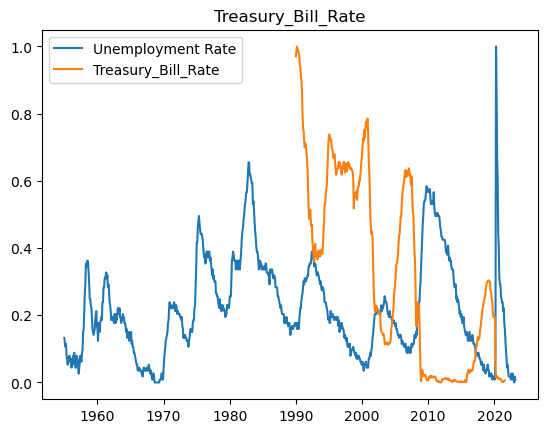

In [23]:
scaler=MinMaxScaler()
df_MRD_us_scaled=scaler.fit_transform(df_MRD_us)
df_MRD_us_scaled=pd.DataFrame(df_MRD_us_scaled,columns=df_MRD_us.columns)

df_MRD_us_scaled.index=df_MRD_us.index

for col in df_MRD_us_scaled.columns:
    if col!='Value':
        plt.plot(df_MRD_us_scaled['Value'],label='Unemployment Rate')
        plt.plot(figsize=(15,5))
        plt.plot(df_MRD_us_scaled[col],label=col)
        plt.title(col)
        plt.legend()
        plt.show()

In [24]:
for col in df_MRD_us_scaled.columns:
    try:
        max_time=df_MRD_us_scaled[~df_MRD_us_scaled[col].isna()].index[-1]
        print('%s : %s'%(col,max_time))
    except IndexError:
        print('%s : No Value Exists'%(col))

Value : 2023-03-01 00:00:00
Electricity_Distribution_Losses : 2023-01-01 00:00:00
Electricity_Final_Consumption_(Calculated) : 2023-01-01 00:00:00
Economic_Activity|Industrial_Production|Index|Base_Year-2010=100 : 2022-08-01 00:00:00
Economic_Activity|Industrial_Production|Manufacturing|Index|Base_Year-2010=100 : 2022-08-01 00:00:00
Industrial_Production|Seasonally_adjusted|Index|Base_Year-2010=100 : 2022-08-01 00:00:00
Financial_Market_Prices|Equities|Index|Base_Year-None : 2017-04-01 00:00:00
Prices|Consumer_Price_Index|All_items|Index|Base_Year-2010=100 : 2023-03-01 00:00:00
Prices|Producer_Price_Index|All_Commodities|Index|Base_Year-2010=100 : 2022-08-01 00:00:00
Production|Base_Year-None : No Value Exists
Employment|Persons|Number_of : 2022-09-01 00:00:00
Labor_Force|Persons|Number_of : 2022-09-01 00:00:00
Change_in_Inventories|Nominal|Undjusted|Domestic_Currency : 2022-12-01 00:00:00
Exports_of_Goods_and_Services|Nominal|Undjusted|Domestic_Currency : 2022-12-01 00:00:00
Gross_Dom

In [25]:
col_not_available=['Electricity_Distribution_Losses',
                   'Electricity_Final_Consumption_(Calculated)',
                   'Production|Base_Year-None',
                   'Employment|Persons|Number_of',
                   'Labor_Force|Persons|Number_of',
                   'Economic_Activity|Industrial_Production|Index|Base_Year-2010=100',
                   'Economic_Activity|Industrial_Production|Manufacturing|Index|Base_Year-2010=100',
                   'Industrial_Production|Seasonally_adjusted|Index|Base_Year-2010=100',
                   'Financial_Market_Prices|Equities|Index|Base_Year-None',
                   'Prices|Producer_Price_Index|All_Commodities|Index|Base_Year-2010=100',
                   'Employment|Persons|Number_of',
                   'Labor_Force|Persons|Number_of',
                   'Central_Bank_Policy_Rate',
                   'Discount_Rate',
                   'Government_Bonds',
                   'Lending_Rate',
                   'Money_Market_Rate',
                   'Treasury_Bill_Rate'
                   ]
                   
col_not_available_high_correlation=[]
                   
df_MRD_us.drop(columns=col_not_available + col_not_available_high_correlation,inplace=True)
df_MRD_us.to_excel(r'Datasets\US_LSTM_MRD.xlsx')